In [1]:
# Para visuzalización en notebook
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (8,6)
mpl.rcParams['font.size'] = 22
from IPython.display import Audio, Markdown, Image
import seaborn as sns

# Números y Datos
import numpy as np
import pandas as pd

# Archivos
import urllib.request
import glob

# Machine learning
# importar los paquetes para clustering
from sklearn.preprocessing import StandardScaler

# Trabajo Práctico 1



In [3]:
# Bajar zip con los datos de audio_analysis
# urllib.request.urlretrieve('https://www.dropbox.com/s/gldffl4k2fmgo70/audio_analysis.zip?dl=1','data/audio_analysis.zip')
#!unzip -qq -o -d data  data/audio_analysis.zip 

## Carga archivos audio_analysis 

In [2]:
audio_analysis_files = glob.glob('data/audio_analysis/timbre/*')
audio_analysis = []
for filename in audio_analysis_files:
    audio_analysis.append( pd.read_csv(filename, index_col='start') )

In [3]:
# Cada elemento del array son todos los muestreos de timbres para cada canción
len(audio_analysis)

2205

In [4]:
audio_analysis[0].head()

,0,1,2,3,4,5,6,7,8,9,10,11
start,,,,,,,,,,,,
0.00000,1.636,137.835,-48.872,-50.316,18.626,-50.032,33.137,7.126,-25.843,9.498,-11.783,-3.756
3.18254,3.826,86.537,-74.743,-79.278,26.734,-44.495,5.566,-15.639,-30.154,10.397,-12.103,-1.636
3.29528,7.793,1.524,-77.794,-98.637,74.196,-42.190,-18.102,-32.863,-14.809,16.868,-9.706,-7.136
3.60431,10.297,-49.566,-92.659,-73.178,96.725,-55.008,-33.347,-2.475,2.226,8.255,-2.616,-4.837
3.73819,11.276,-65.734,-87.715,-62.323,104.899,-60.900,-30.793,7.133,3.330,0.801,2.777,-0.685


In [5]:
audio_analysis[1].head()

,0,1,2,3,4,5,6,7,8,9,10,11
start,,,,,,,,,,,,
0.00000,29.948,-263.655,-62.040,12.260,45.829,-22.429,2.557,36.086,-6.454,15.756,-2.532,-11.219
0.53256,24.125,-202.506,-53.504,-19.599,41.436,-46.944,5.250,37.375,-23.118,-10.157,-0.197,-17.188
1.62000,20.323,-169.552,-72.397,-21.023,54.894,-60.891,8.809,35.725,-26.365,-16.623,-3.795,-8.481
3.21615,30.833,-233.788,-35.370,-1.579,24.313,-28.755,-12.388,10.303,-15.967,10.205,-6.901,-4.627
3.57107,26.232,-204.507,-43.457,-49.504,15.505,-37.535,0.125,16.636,-21.994,-19.245,-0.098,-1.136


In [6]:
audio_analysis[0].shape

(804, 12)

In [7]:
audio_analysis[0].describe()

,0,1,2,3,4,5,6,7,8,9,10,11
count,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000,915.000000
mean,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,-1.074585,-0.824331
std,7.664607,46.780848,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
min,10.050000,-146.206000,-15.477000,-66.960000,-31.903000,-76.043000,-65.114000,-41.558000,-45.446000,-25.482000,-23.056000,-53.623000
25%,35.735500,-91.602000,17.350500,-22.567000,-0.495000,-40.207500,-5.175000,-6.179500,-13.797000,-8.837500,-5.447500,-7.321500
50%,42.377000,-58.243000,32.253000,-14.285000,7.447000,-34.138000,3.410000,0.988000,-7.816000,-3.258000,-0.967000,-0.577000
75%,45.263500,-23.745000,45.536000,-5.761000,18.707000,-28.942000,10.745500,6.788000,-2.081500,1.911000,3.674000,6.628000
max,49.377000,188.202000,147.011000,60.207000,80.725000,2.073000,36.631000,38.336000,14.590000,26.911000,18.059000,32.580000


In [12]:
audio_analysis[0].mean()

0      7.466812
1     33.744083
2     70.433843
3     33.757991
4     18.049097
5     11.822311
6     24.872901
7     10.004906
8     12.655114
9      7.062304
10     6.973931
11    12.630271
dtype: float64

In [9]:
audio_analysis[0].std()

0      7.664607
1     46.780848
2     24.761365
3     14.200565
4     17.446560
5      9.698054
6     14.747012
7     10.249290
8     10.888898
9      7.967957
10     6.617408
11    11.606093
dtype: float64

In [10]:
audio_analysis[0].columns

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11'], dtype='object')

In [7]:
col_mean_renames = {}
for i in range(12):
    col_mean_renames.update({str(i): 'timbre_mean_' + str(i)})
col_mean_renames

{'0': 'timbre_mean_0',
 '1': 'timbre_mean_1',
 '2': 'timbre_mean_2',
 '3': 'timbre_mean_3',
 '4': 'timbre_mean_4',
 '5': 'timbre_mean_5',
 '6': 'timbre_mean_6',
 '7': 'timbre_mean_7',
 '8': 'timbre_mean_8',
 '9': 'timbre_mean_9',
 '10': 'timbre_mean_10',
 '11': 'timbre_mean_11'}

In [15]:
col_std_renames = {}
for i in range(12):
    col_std_renames.update({str(i): 'timbre_std_' + str(i)})
col_std_renames

{'0': 'timbre_std_0',
 '1': 'timbre_std_1',
 '2': 'timbre_std_2',
 '3': 'timbre_std_3',
 '4': 'timbre_std_4',
 '5': 'timbre_std_5',
 '6': 'timbre_std_6',
 '7': 'timbre_std_7',
 '8': 'timbre_std_8',
 '9': 'timbre_std_9',
 '10': 'timbre_std_10',
 '11': 'timbre_std_11'}

In [13]:
timbres_means = []
for song in audio_analysis:
    timbres_means.append(song.mean())
df_timbres_means = pd.DataFrame(timbres_means)
df_timbres_means = df_timbres_means.rename(columns = col_mean_renames)
df_timbres_means.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,timbre_mean_10,timbre_mean_11
0,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,-1.074585,-0.824331
1,37.806990,26.905931,45.066553,-1.566750,19.836837,-10.684136,-37.983923,-10.510028,-5.820575,-1.746866,-5.941400,-0.282435
2,50.307463,65.649677,-17.158870,-1.660690,30.536530,-47.617183,1.200309,1.357931,-2.241743,4.456728,-8.276168,-5.888623
3,38.453838,-46.715751,-16.638915,-3.838850,34.693517,-27.530044,5.632033,2.938340,7.223357,-0.045737,-11.028171,-1.748513
4,52.072411,98.597172,-16.693923,0.843767,42.616539,-42.602253,-3.609067,11.836476,2.011623,0.462091,-9.126143,-1.358982


In [14]:
timbres_stds = []
for song in audio_analysis:
    timbres_stds.append(song.std())
df_timbres_stds = pd.DataFrame(timbres_stds)
df_timbres_stds = df_timbres_stds.rename(columns = col_std_renames)
df_timbres_stds.head()

,timbre_std_0,timbre_std_1,timbre_std_2,timbre_std_3,timbre_std_4,timbre_std_5,timbre_std_6,timbre_std_7,timbre_std_8,timbre_std_9,timbre_std_10,timbre_std_11
0,7.664607,46.780848,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,6.555402,61.683571,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,6.399544,54.450290,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,8.501100,82.117230,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,4.995148,52.319897,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


In [15]:
df_timbres = pd.concat([df_timbres_means, df_timbres_stds], axis = 1)
df_timbres.shape

(2205, 24)

In [16]:
df_timbres.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,timbre_std_2,timbre_std_3,timbre_std_4,timbre_std_5,timbre_std_6,timbre_std_7,timbre_std_8,timbre_std_9,timbre_std_10,timbre_std_11
0,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,...,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,37.806990,26.905931,45.066553,-1.566750,19.836837,-10.684136,-37.983923,-10.510028,-5.820575,-1.746866,...,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,50.307463,65.649677,-17.158870,-1.660690,30.536530,-47.617183,1.200309,1.357931,-2.241743,4.456728,...,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,38.453838,-46.715751,-16.638915,-3.838850,34.693517,-27.530044,5.632033,2.938340,7.223357,-0.045737,...,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,52.072411,98.597172,-16.693923,0.843767,42.616539,-42.602253,-3.609067,11.836476,2.011623,0.462091,...,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


Repetimos el mismo procedimiento con los pitches

In [35]:
pitches_files = glob.glob('data/audio_analysis/pitches/*')
pitches = []
for filename in pitches_files:
    pitches.append(pd.read_csv(filename, index_col='start'))

In [18]:
# Cada elemento del array son todos los muestreos de pitches para cada canción
len(pitches)

2205

In [19]:
pitches[0].head()

,0,1,2,3,4,5,6,7,8,9,10,11
start,,,,,,,,,,,,
0.00000,0.239,1.000,0.891,0.099,0.083,0.215,0.322,0.172,0.108,0.415,0.200,0.124
0.33488,0.334,1.000,0.957,0.152,0.060,0.257,0.288,0.136,0.070,0.203,0.104,0.091
0.58481,0.042,0.302,1.000,0.104,0.060,0.137,0.137,0.082,0.129,0.341,0.115,0.052
1.17778,0.034,0.277,1.000,0.091,0.045,0.093,0.079,0.087,0.068,0.294,0.122,0.057
2.07882,0.330,1.000,0.688,0.379,0.162,0.354,0.352,0.413,0.515,0.646,0.494,0.198


In [20]:
col_mean_renames = {}
for i in range(12):
    col_mean_renames.update({str(i): 'pitch_mean_' + str(i)})
col_mean_renames

{'0': 'pitch_mean_0',
 '1': 'pitch_mean_1',
 '2': 'pitch_mean_2',
 '3': 'pitch_mean_3',
 '4': 'pitch_mean_4',
 '5': 'pitch_mean_5',
 '6': 'pitch_mean_6',
 '7': 'pitch_mean_7',
 '8': 'pitch_mean_8',
 '9': 'pitch_mean_9',
 '10': 'pitch_mean_10',
 '11': 'pitch_mean_11'}

In [21]:
col_std_renames = {}
for i in range(12):
    col_std_renames.update({str(i): 'pitch_std_' + str(i)})
col_std_renames

{'0': 'pitch_std_0',
 '1': 'pitch_std_1',
 '2': 'pitch_std_2',
 '3': 'pitch_std_3',
 '4': 'pitch_std_4',
 '5': 'pitch_std_5',
 '6': 'pitch_std_6',
 '7': 'pitch_std_7',
 '8': 'pitch_std_8',
 '9': 'pitch_std_9',
 '10': 'pitch_std_10',
 '11': 'pitch_std_11'}

In [22]:
pitches_means = []
for song in pitches:
    pitches_means.append(song.mean())
df_pitches_means = pd.DataFrame(pitches_means)
df_pitches_means = df_pitches_means.rename(columns = col_mean_renames)
df_pitches_means.head()

,pitch_mean_0,pitch_mean_1,pitch_mean_2,pitch_mean_3,pitch_mean_4,pitch_mean_5,pitch_mean_6,pitch_mean_7,pitch_mean_8,pitch_mean_9,pitch_mean_10,pitch_mean_11
0,0.375884,0.542515,0.693280,0.297933,0.253832,0.511824,0.284066,0.179025,0.165990,0.571667,0.170922,0.124420
1,0.345639,0.271609,0.292444,0.230944,0.386810,0.314941,0.256701,0.387723,0.156433,0.236743,0.267108,0.233731
2,0.457729,0.517120,0.492810,0.367588,0.364575,0.376027,0.325243,0.395297,0.321865,0.378783,0.317345,0.253317
3,0.383214,0.351185,0.198129,0.195749,0.539399,0.283789,0.210853,0.294865,0.301922,0.763953,0.338184,0.217922
4,0.526263,0.743888,0.385282,0.383604,0.451625,0.371914,0.359564,0.285318,0.386283,0.274957,0.318695,0.334018


In [23]:
pitches_stds = []
for song in pitches:
    pitches_stds.append(song.std())
df_pitches_stds = pd.DataFrame(pitches_stds)
df_pitches_stds = df_pitches_stds.rename(columns = col_std_renames)
df_pitches_stds.head()

,pitch_std_0,pitch_std_1,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
0,0.240662,0.324290,0.314326,0.182297,0.175415,0.315322,0.197047,0.190721,0.152499,0.315809,0.165763,0.112952
1,0.322026,0.275938,0.293350,0.250039,0.339806,0.311496,0.260636,0.341519,0.176243,0.284082,0.300141,0.236217
2,0.314328,0.374977,0.361503,0.331288,0.333903,0.320905,0.290592,0.337753,0.306255,0.320579,0.347926,0.315364
3,0.331935,0.272240,0.211055,0.172432,0.307475,0.226574,0.209167,0.271316,0.221715,0.297126,0.209825,0.216391
4,0.276997,0.324415,0.277745,0.307850,0.362859,0.300253,0.295673,0.236315,0.301466,0.244227,0.257769,0.281606


In [24]:
df_pitches = pd.concat([df_pitches_means, df_pitches_stds], axis = 1)
df_pitches.shape

(2205, 24)

In [25]:
df_pitches.head()

,pitch_mean_0,pitch_mean_1,pitch_mean_2,pitch_mean_3,pitch_mean_4,pitch_mean_5,pitch_mean_6,pitch_mean_7,pitch_mean_8,pitch_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
0,0.375884,0.542515,0.693280,0.297933,0.253832,0.511824,0.284066,0.179025,0.165990,0.571667,...,0.314326,0.182297,0.175415,0.315322,0.197047,0.190721,0.152499,0.315809,0.165763,0.112952
1,0.345639,0.271609,0.292444,0.230944,0.386810,0.314941,0.256701,0.387723,0.156433,0.236743,...,0.293350,0.250039,0.339806,0.311496,0.260636,0.341519,0.176243,0.284082,0.300141,0.236217
2,0.457729,0.517120,0.492810,0.367588,0.364575,0.376027,0.325243,0.395297,0.321865,0.378783,...,0.361503,0.331288,0.333903,0.320905,0.290592,0.337753,0.306255,0.320579,0.347926,0.315364
3,0.383214,0.351185,0.198129,0.195749,0.539399,0.283789,0.210853,0.294865,0.301922,0.763953,...,0.211055,0.172432,0.307475,0.226574,0.209167,0.271316,0.221715,0.297126,0.209825,0.216391
4,0.526263,0.743888,0.385282,0.383604,0.451625,0.371914,0.359564,0.285318,0.386283,0.274957,...,0.277745,0.307850,0.362859,0.300253,0.295673,0.236315,0.301466,0.244227,0.257769,0.281606


In [26]:
df_audio_analysis_summaries = pd.concat([df_timbres, df_pitches], axis = 1)
df_audio_analysis_summaries.shape

(2205, 48)

In [27]:
df_audio_analysis_summaries.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
0,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,...,0.314326,0.182297,0.175415,0.315322,0.197047,0.190721,0.152499,0.315809,0.165763,0.112952
1,37.806990,26.905931,45.066553,-1.566750,19.836837,-10.684136,-37.983923,-10.510028,-5.820575,-1.746866,...,0.293350,0.250039,0.339806,0.311496,0.260636,0.341519,0.176243,0.284082,0.300141,0.236217
2,50.307463,65.649677,-17.158870,-1.660690,30.536530,-47.617183,1.200309,1.357931,-2.241743,4.456728,...,0.361503,0.331288,0.333903,0.320905,0.290592,0.337753,0.306255,0.320579,0.347926,0.315364
3,38.453838,-46.715751,-16.638915,-3.838850,34.693517,-27.530044,5.632033,2.938340,7.223357,-0.045737,...,0.211055,0.172432,0.307475,0.226574,0.209167,0.271316,0.221715,0.297126,0.209825,0.216391
4,52.072411,98.597172,-16.693923,0.843767,42.616539,-42.602253,-3.609067,11.836476,2.011623,0.462091,...,0.277745,0.307850,0.362859,0.300253,0.295673,0.236315,0.301466,0.244227,0.257769,0.281606


In [28]:
df_audio_analysis_summaries.shape

(2205, 48)

In [41]:
df_audio_analysis_summaries.columns

Index(['timbre_mean_0', 'timbre_mean_1', 'timbre_mean_2', 'timbre_mean_3',
       'timbre_mean_4', 'timbre_mean_5', 'timbre_mean_6', 'timbre_mean_7',
       'timbre_mean_8', 'timbre_mean_9', 'timbre_mean_10', 'timbre_mean_11',
       'timbre_std_0', 'timbre_std_1', 'timbre_std_2', 'timbre_std_3',
       'timbre_std_4', 'timbre_std_5', 'timbre_std_6', 'timbre_std_7',
       'timbre_std_8', 'timbre_std_9', 'timbre_std_10', 'timbre_std_11',
       'pitch_mean_0', 'pitch_mean_1', 'pitch_mean_2', 'pitch_mean_3',
       'pitch_mean_4', 'pitch_mean_5', 'pitch_mean_6', 'pitch_mean_7',
       'pitch_mean_8', 'pitch_mean_9', 'pitch_mean_10', 'pitch_mean_11',
       'pitch_std_0', 'pitch_std_1', 'pitch_std_2', 'pitch_std_3',
       'pitch_std_4', 'pitch_std_5', 'pitch_std_6', 'pitch_std_7',
       'pitch_std_8', 'pitch_std_9', 'pitch_std_10', 'pitch_std_11'],
      dtype='object')

In [30]:
df_audio_analysis_summaries.describe()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
count,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,...,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000
mean,40.550732,-13.228130,3.239358,-4.822117,26.385584,-27.895583,-3.296531,0.870708,-7.290918,0.210211,...,0.270906,0.246348,0.269752,0.267857,0.259039,0.278531,0.259864,0.276710,0.256972,0.262975
std,8.459793,73.838347,37.216646,16.684266,18.979127,12.756940,13.009485,7.203944,7.942545,4.769673,...,0.068294,0.072780,0.068958,0.072260,0.069416,0.069067,0.069192,0.067136,0.070456,0.070024
min,10.021237,-274.008816,-186.848166,-73.423971,-37.972974,-76.657314,-49.452199,-39.663836,-47.011166,-17.788300,...,0.030583,0.023184,0.024037,0.039711,0.026122,0.022826,0.027297,0.024222,0.027442,0.024878
25%,34.700799,-57.812048,-20.689557,-14.585080,14.088190,-35.721470,-11.435330,-3.101767,-12.144103,-3.075144,...,0.229882,0.200942,0.226633,0.223834,0.218458,0.239197,0.221319,0.238497,0.216202,0.220264
50%,41.087870,-8.958767,2.973857,-4.920280,25.103923,-28.372441,-3.313508,1.009404,-7.292971,0.093846,...,0.279256,0.251417,0.277401,0.279822,0.264118,0.291527,0.266566,0.285007,0.264842,0.267954
75%,47.294952,43.837232,26.280591,4.781999,37.008170,-19.348597,4.837479,5.277271,-2.500729,3.416247,...,0.320505,0.298545,0.318749,0.319472,0.307701,0.326606,0.310736,0.322995,0.307276,0.314354
max,56.792370,155.588085,162.424957,88.001531,109.935316,26.260637,54.655340,50.305639,26.759921,26.906087,...,0.450594,0.444766,0.452476,0.432160,0.451997,0.437747,0.439321,0.436187,0.441696,0.430164


In [33]:
corrs_ordered = df_audio_analysis_summaries.corr().unstack().sort_values(kind = "quicksort")
corrs_ordered[(corrs_ordered >= 0.8) & (corrs_ordered != 1)]

timbre_std_3   timbre_std_10    0.845241
timbre_std_10  timbre_std_3     0.845241
timbre_std_9   timbre_std_7     0.868490
timbre_std_7   timbre_std_9     0.868490
timbre_std_5   timbre_std_10    0.871723
timbre_std_10  timbre_std_5     0.871723
dtype: float64

In [40]:
corrs_ordered['timbre_std_5', 'timbre_std_3']

0.7679716447864754

In [37]:
corrs_ordered[corrs_ordered <= -0.8]

Series([], dtype: float64)

In [38]:
df_audio_analysis_summaries.corr()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
timbre_mean_0,1.000000,0.700038,-0.032585,0.258969,-0.376145,-0.119554,0.160785,-0.091707,0.103257,0.353445,...,0.037961,0.108053,0.091710,0.123396,0.185112,0.155169,0.169301,0.072561,0.164626,0.163103
timbre_mean_1,0.700038,1.000000,0.169106,0.334746,-0.240219,-0.011592,-0.003412,0.007532,0.008403,0.423439,...,0.126873,0.182720,0.121272,0.216858,0.213863,0.215154,0.194702,0.104002,0.228183,0.219819
timbre_mean_2,-0.032585,0.169106,1.000000,0.353749,0.165798,0.261620,0.016571,0.089005,-0.149555,-0.295483,...,0.071176,-0.012620,0.035529,0.010158,-0.056226,0.039459,-0.036902,0.076768,-0.060596,-0.022212
timbre_mean_3,0.258969,0.334746,0.353749,1.000000,0.072346,0.118424,0.080620,-0.082186,-0.138891,0.160305,...,0.113157,0.069157,0.073095,0.131304,0.080025,0.126749,0.084138,0.089241,0.074913,0.065042
timbre_mean_4,-0.376145,-0.240219,0.165798,0.072346,1.000000,-0.018167,-0.234590,0.144114,-0.042334,-0.079845,...,0.041213,0.017868,-0.033677,0.028351,-0.057288,-0.011612,-0.019227,-0.030406,-0.041315,-0.078543
timbre_mean_5,-0.119554,-0.011592,0.261620,0.118424,-0.018167,1.000000,-0.301539,-0.216300,0.107460,-0.240046,...,0.076695,0.004362,-0.007608,0.033294,-0.131554,0.010161,-0.066099,0.040699,0.002452,-0.027556
timbre_mean_6,0.160785,-0.003412,0.016571,0.080620,-0.234590,-0.301539,1.000000,0.309789,-0.177011,0.009280,...,-0.040917,0.042769,-0.007140,0.015765,0.028434,0.021330,0.102652,-0.004756,0.062826,0.009077
timbre_mean_7,-0.091707,0.007532,0.089005,-0.082186,0.144114,-0.216300,0.309789,1.000000,-0.264059,0.068623,...,0.025383,0.056212,-0.056183,0.036575,-0.005013,0.008968,0.082043,-0.043911,0.053965,-0.008784
timbre_mean_8,0.103257,0.008403,-0.149555,-0.138891,-0.042334,0.107460,-0.177011,-0.264059,1.000000,0.371463,...,0.004792,0.001484,-0.044153,-0.016985,-0.001981,-0.010484,-0.013998,-0.019952,0.001896,-0.018437
timbre_mean_9,0.353445,0.423439,-0.295483,0.160305,-0.079845,-0.240046,0.009280,0.068623,0.371463,1.000000,...,0.080511,0.098522,0.008401,0.124986,0.116430,0.113937,0.107146,0.000564,0.145031,0.113289


In [39]:
corrs_ordered.shape

(2304,)

In [44]:
# Vamos a hacer la scatter matrix de solo los timbre_std
df_timbres_std = df_audio_analysis_summaries.iloc[:,12:24]
df_timbres_std.columns

Index(['timbre_std_0', 'timbre_std_1', 'timbre_std_2', 'timbre_std_3',
       'timbre_std_4', 'timbre_std_5', 'timbre_std_6', 'timbre_std_7',
       'timbre_std_8', 'timbre_std_9', 'timbre_std_10', 'timbre_std_11'],
      dtype='object')

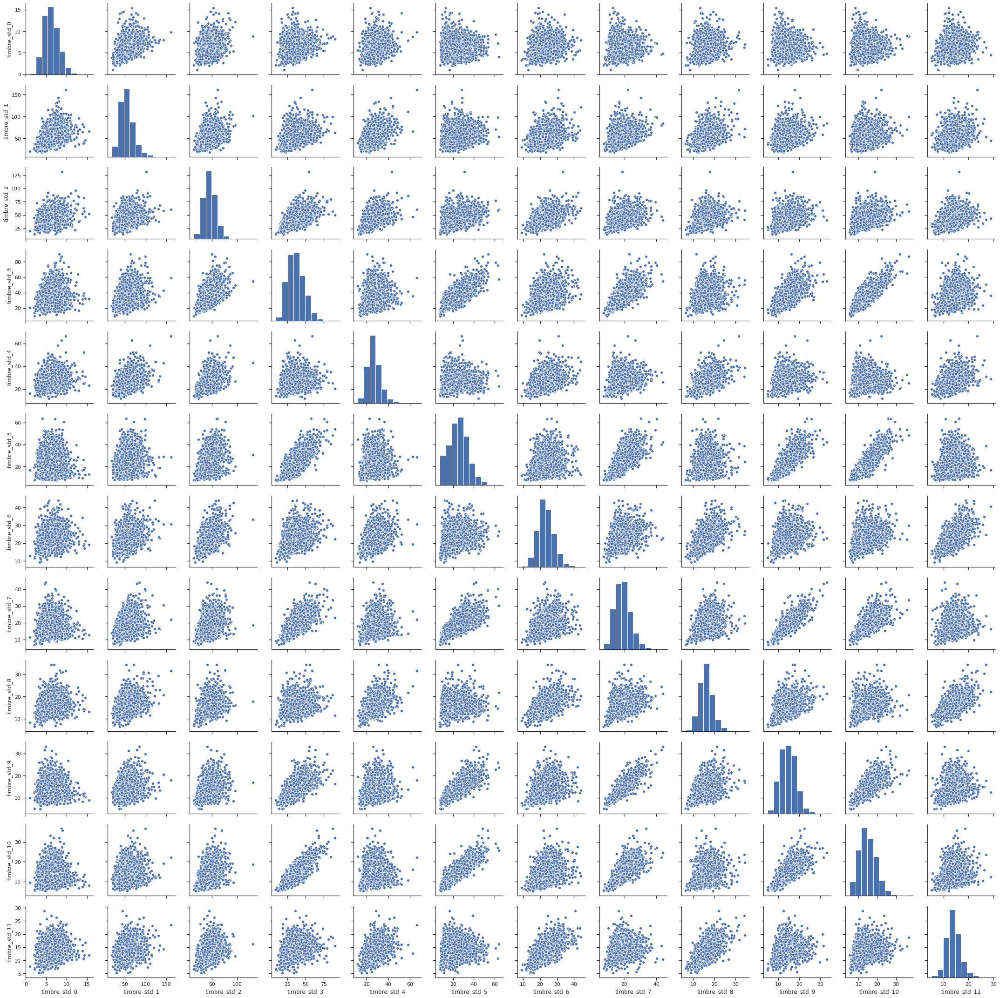

In [46]:
sns.set(style="ticks")
sns.pairplot(df_timbres_std)

In [47]:
# Vamos a hacer la scatter matrix de los promedios
df_audio_analysis_summaries_means = pd.concat([df_audio_analysis_summaries.iloc[:,0:12], df_audio_analysis_summaries.iloc[:,24:36]], axis = 1)
df_audio_analysis_summaries_means.columns

Index(['timbre_mean_0', 'timbre_mean_1', 'timbre_mean_2', 'timbre_mean_3',
       'timbre_mean_4', 'timbre_mean_5', 'timbre_mean_6', 'timbre_mean_7',
       'timbre_mean_8', 'timbre_mean_9', 'timbre_mean_10', 'timbre_mean_11',
       'pitch_mean_0', 'pitch_mean_1', 'pitch_mean_2', 'pitch_mean_3',
       'pitch_mean_4', 'pitch_mean_5', 'pitch_mean_6', 'pitch_mean_7',
       'pitch_mean_8', 'pitch_mean_9', 'pitch_mean_10', 'pitch_mean_11'],
      dtype='object')

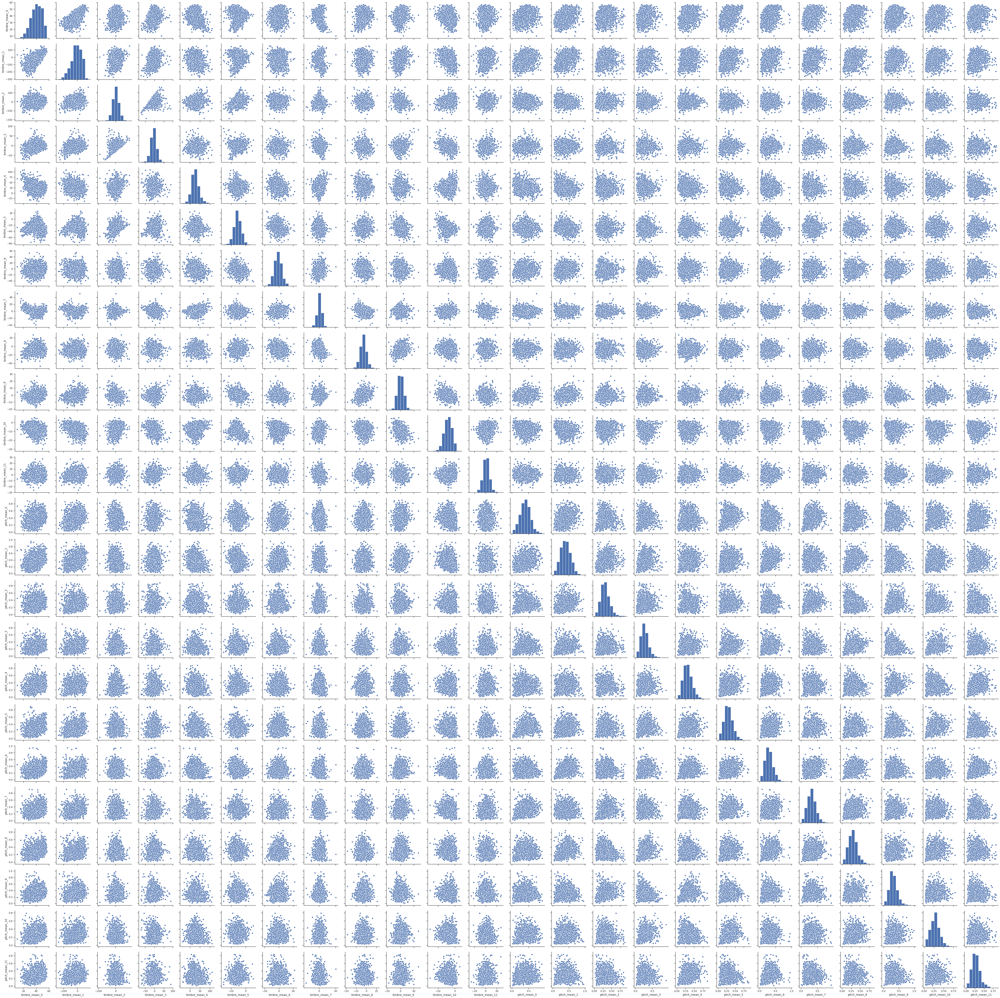

In [48]:
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_means)

In [49]:
# Vamos a hacer la scatter matrix de las desviaciones
df_audio_analysis_summaries_std = pd.concat([df_audio_analysis_summaries.iloc[:,13:24], df_audio_analysis_summaries.iloc[:,37:48]], axis = 1)
df_audio_analysis_summaries_std.columns

Index(['timbre_std_1', 'timbre_std_2', 'timbre_std_3', 'timbre_std_4',
       'timbre_std_5', 'timbre_std_6', 'timbre_std_7', 'timbre_std_8',
       'timbre_std_9', 'timbre_std_10', 'timbre_std_11', 'pitch_std_1',
       'pitch_std_2', 'pitch_std_3', 'pitch_std_4', 'pitch_std_5',
       'pitch_std_6', 'pitch_std_7', 'pitch_std_8', 'pitch_std_9',
       'pitch_std_10', 'pitch_std_11'],
      dtype='object')

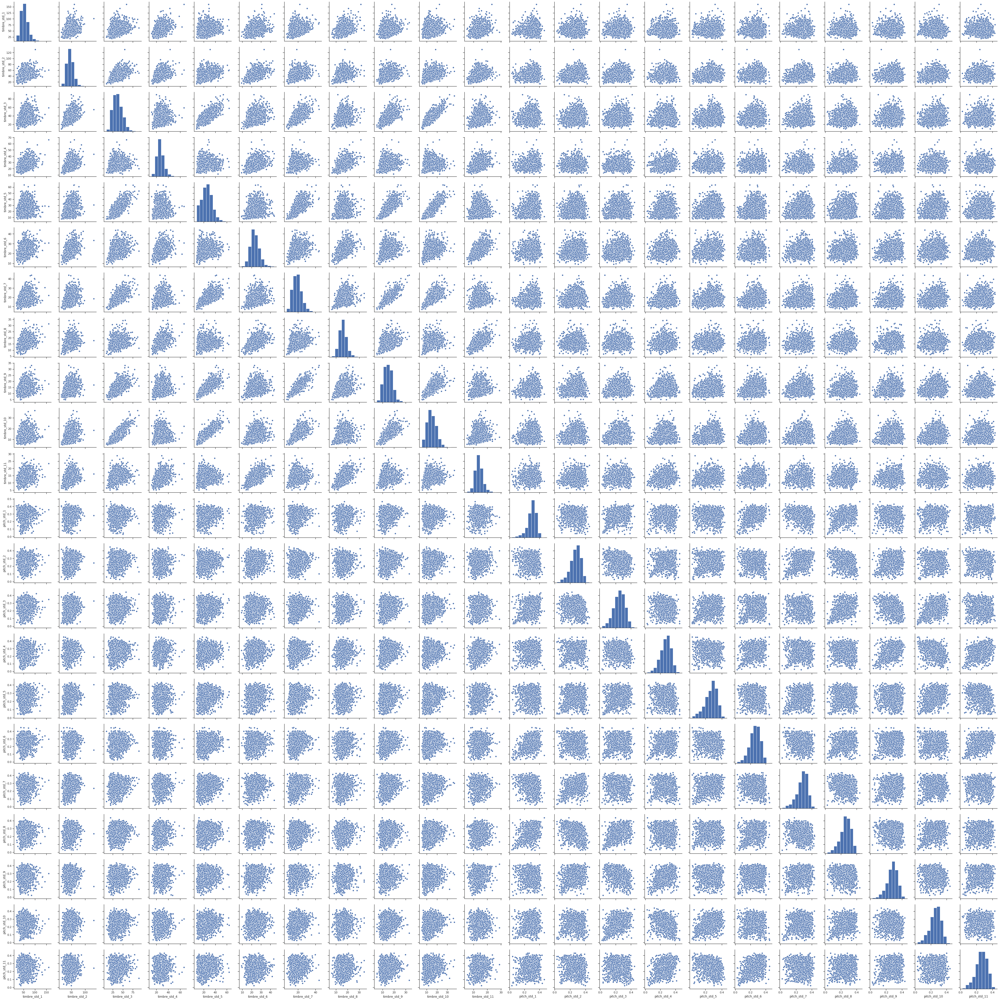

In [50]:
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_std)

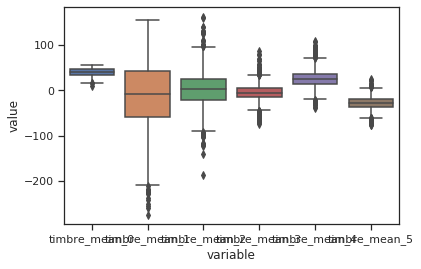

In [56]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,0:6]))

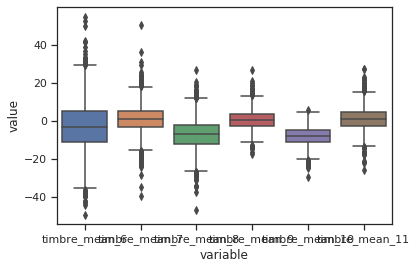

In [57]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,6:12]))

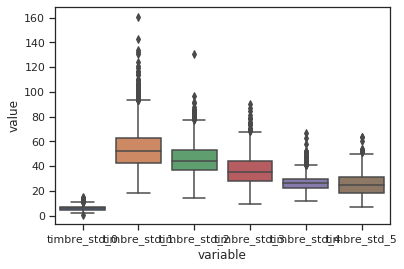

In [58]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,12:18]))

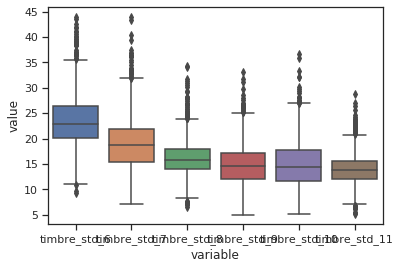

In [59]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,18:24]))

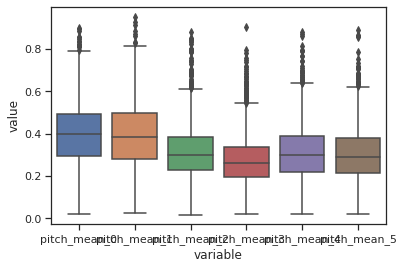

In [61]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,24:30]))

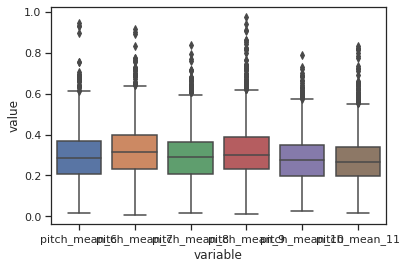

In [62]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,30:36]))

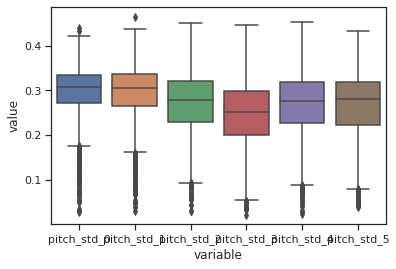

In [63]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,36:42]))

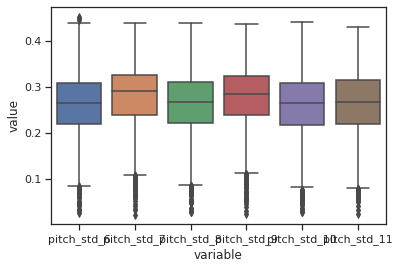

In [64]:
sns.boxplot(x = 'variable', y = 'value', data = pd.melt(df_audio_analysis_summaries.iloc[:,42:48]))

In [27]:
#Se reemplaza la media y desvio por la mediana y el MAD. Recorda que lo que se está haciendo para cada tema 
# y no para el dataset
#En el momento de aplicar clusters se podría hacer la prueba 
col_median_renames = {}
for i in range(12):
    col_median_renames.update({str(i): 'timbre_median_' + str(i)})
col_mad_renames = {}
for i in range(12):
    col_mad_renames.update({str(i): 'timbre_mad_' + str(i)})

timbres_medians = []
for song in audio_analysis:
    timbres_medians.append(song.median())
df_timbres_medians = pd.DataFrame(timbres_medians)
df_timbres_medians = df_timbres_medians.rename(columns = col_median_renames)

timbres_mad = []
for song in audio_analysis:
    timbres_mad.append(song.mad())
df_timbres_mad = pd.DataFrame(timbres_mad)
df_timbres_mad = df_timbres_mad.rename(columns = col_mad_renames)


In [32]:
df_timbres_rob = pd.concat([df_timbres_medians, df_timbres_mad], axis = 1)
df_timbres_rob.head()




,timbre_median_0,timbre_median_1,timbre_median_2,timbre_median_3,timbre_median_4,timbre_median_5,timbre_median_6,timbre_median_7,timbre_median_8,timbre_median_9,...,timbre_mad_2,timbre_mad_3,timbre_mad_4,timbre_mad_5,timbre_mad_6,timbre_mad_7,timbre_mad_8,timbre_mad_9,timbre_mad_10,timbre_mad_11
0,22.1860,-78.354,33.5710,-14.2415,70.726,-40.6115,-2.9945,5.2825,-7.6025,0.1470,...,70.433843,33.757991,18.049097,11.822311,24.872901,10.004906,12.655114,7.062304,6.973931,12.630271
1,29.2570,-154.425,-20.1600,0.0760,35.890,-38.9480,-8.3680,10.3030,-9.9400,-5.3640,...,27.841011,25.032735,18.227374,15.365787,13.145787,11.876709,11.209972,8.462609,6.310091,6.957070
2,38.9000,-28.929,29.4740,62.2810,28.854,-24.2000,-5.7560,-5.7910,-4.4530,5.2480,...,33.639245,38.348195,20.593992,25.149035,26.317897,16.206760,13.030410,12.762815,17.193077,14.862734
3,27.8290,-70.146,15.4720,-24.1890,28.373,-27.8340,-14.9250,1.0900,-10.1680,-4.3980,...,35.010768,23.737139,17.636494,10.609784,16.462887,11.770864,11.942474,8.598513,8.944310,11.617657
4,33.9885,-64.802,-74.5595,-17.4525,35.625,-34.0370,-1.8560,-9.0755,-0.9620,1.6065,...,36.261961,45.668030,20.800602,34.679645,17.750079,17.200258,13.744794,15.168282,17.802213,8.717208


In [36]:
col_median_renames = {}
for i in range(12):
    col_median_renames.update({str(i): 'pitch_median_' + str(i)})
col_mad_renames = {}
for i in range(12):
    col_mad_renames.update({str(i): 'pitch_mad_' + str(i)})

pitches_medians = []
for song in pitches:
    pitches_medians.append(song.median())
df_pitches_medians = pd.DataFrame(pitches_medians)
df_pitches_medians = df_pitches_medians.rename(columns = col_median_renames)

pitches_mad = []
for song in pitches:
    pitches_mad.append(song.mad())
df_pitches_mad = pd.DataFrame(pitches_mad)
df_pitches_mad = df_pitches_mad.rename(columns = col_mad_renames)
df_pitches_mad.head()

df_pitches_rob = pd.concat([df_pitches_medians, df_pitches_mad], axis = 1)
df_pitches_rob.head()



,pitch_median_0,pitch_median_1,pitch_median_2,pitch_median_3,pitch_median_4,pitch_median_5,pitch_median_6,pitch_median_7,pitch_median_8,pitch_median_9,...,pitch_mad_2,pitch_mad_3,pitch_mad_4,pitch_mad_5,pitch_mad_6,pitch_mad_7,pitch_mad_8,pitch_mad_9,pitch_mad_10,pitch_mad_11
0,0.170,0.537,0.199,0.1265,0.083,0.1690,0.3615,0.1340,0.155,0.113,...,0.199476,0.225614,0.097479,0.205828,0.266222,0.152272,0.263526,0.163233,0.240083,0.192749
1,0.061,0.719,0.093,0.0230,0.021,0.0860,1.0000,0.0640,0.139,0.167,...,0.175872,0.015561,0.013418,0.072365,0.432246,0.035241,0.294576,0.161209,0.016368,0.204527
2,0.227,0.224,0.140,0.1140,0.093,0.1490,0.0880,0.0970,0.152,0.115,...,0.216526,0.151578,0.158559,0.251905,0.167416,0.218327,0.253709,0.220088,0.233082,0.123233
3,0.171,0.108,0.071,0.1350,0.104,0.0810,0.1120,0.1070,0.167,0.065,...,0.127940,0.269766,0.212064,0.186701,0.228080,0.199237,0.277173,0.131384,0.182288,0.273488
4,0.548,0.868,0.202,0.1800,0.183,0.2475,0.2040,0.1665,0.205,0.212,...,0.175082,0.195492,0.198881,0.251200,0.216068,0.157945,0.243908,0.243529,0.170867,0.138238


In [37]:
df_audio_analysis_rob_summaries = pd.concat([df_timbres_rob, df_pitches_rob], axis = 1)
df_audio_analysis_rob_summaries.head()


,timbre_median_0,timbre_median_1,timbre_median_2,timbre_median_3,timbre_median_4,timbre_median_5,timbre_median_6,timbre_median_7,timbre_median_8,timbre_median_9,...,pitch_mad_2,pitch_mad_3,pitch_mad_4,pitch_mad_5,pitch_mad_6,pitch_mad_7,pitch_mad_8,pitch_mad_9,pitch_mad_10,pitch_mad_11
0,22.1860,-78.354,33.5710,-14.2415,70.726,-40.6115,-2.9945,5.2825,-7.6025,0.1470,...,0.199476,0.225614,0.097479,0.205828,0.266222,0.152272,0.263526,0.163233,0.240083,0.192749
1,29.2570,-154.425,-20.1600,0.0760,35.890,-38.9480,-8.3680,10.3030,-9.9400,-5.3640,...,0.175872,0.015561,0.013418,0.072365,0.432246,0.035241,0.294576,0.161209,0.016368,0.204527
2,38.9000,-28.929,29.4740,62.2810,28.854,-24.2000,-5.7560,-5.7910,-4.4530,5.2480,...,0.216526,0.151578,0.158559,0.251905,0.167416,0.218327,0.253709,0.220088,0.233082,0.123233
3,27.8290,-70.146,15.4720,-24.1890,28.373,-27.8340,-14.9250,1.0900,-10.1680,-4.3980,...,0.127940,0.269766,0.212064,0.186701,0.228080,0.199237,0.277173,0.131384,0.182288,0.273488
4,33.9885,-64.802,-74.5595,-17.4525,35.625,-34.0370,-1.8560,-9.0755,-0.9620,1.6065,...,0.175082,0.195492,0.198881,0.251200,0.216068,0.157945,0.243908,0.243529,0.170867,0.138238


In [40]:
corrs_rob_ordered = df_audio_analysis_rob_summaries.corr().unstack().sort_values(kind = "quicksort")
corrs_rob_ordered[(corrs_rob_ordered >= 0.8) & (corrs_rob_ordered != 1)]

timbre_mad_3   timbre_mad_10    0.817628
timbre_mad_10  timbre_mad_3     0.817628
timbre_mad_9   timbre_mad_7     0.859294
timbre_mad_7   timbre_mad_9     0.859294
timbre_mad_5   timbre_mad_10    0.871970
timbre_mad_10  timbre_mad_5     0.871970
dtype: float64